In [9]:
import datajoint as dj
import numpy as np

import trimesh
import time
from collections import Counter

In [31]:
pinky = dj.create_virtual_module("pinky","microns_pinky")
schema = dj.schema("microns_pinky")

In [ ]:
pinky.ExcitatoryStitchedMeshVp2

In [ ]:
pinky.OrphanStitchedMeshVp2

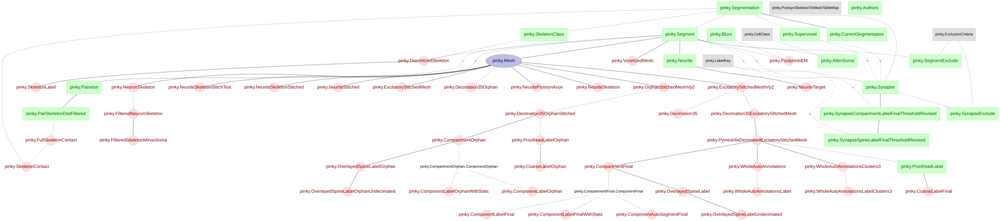

In [32]:
dj.ERD(schema)

In [11]:
"""
Pseudocode:
1) Get the mesh
2) Get the labels
3) Get the indexes of labels that are
    not error or spines
4) Get a submesh based on the kept indexes
5) Print that out

"""

'\nPseudocode:\n1) Get the mesh\n2) Get the labels\n3) Get the indexes of labels that are\n    not error or spines\n4) Get a submesh based on the kept indexes\n5) Print that out\n\n'

In [22]:
#get the mesh and labels
def remove_errors_and_spines(key):
    full_start = time.time()
    start_time = time.time()
    #find out if in Orphan Table or Regular Neuron Table
    if len(pinky.CoarseLabelFinal() & key) > 0:
        mesh = (pinky.Mesh() & key).fetch1()
        mesh_labels = (pinky.OverlayedSpineLabelUndecimated & key).fetch1()["triangles"]
    elif len(pinky.CoarseLabelOrphan() & key) > 0:
        mesh = (pinky.Mesh() & key).fetch1()
        mesh_labels = (pinky.OverlayedSpineLabelOrphanUndecimated & key).fetch1()["triangles"]
    else:
        raise Exception('neuron' + str(key["segment_id"]) + 
                        'not present in any labels!')
    
    print(key['segment_id'], "mesh fetched.", time.time() - start_time)
    start = time.time()
    
    #print(mesh['triangles'])
    myCounter = Counter(mesh_labels)#.tolist())
    print(myCounter)
    
    keys = list(myCounter.keys())
    #print(len(keys))
    
    if len(keys) < 2 and keys[0] == 10:
        print("only error segments")
        key['n_vertices'] = 0
        key['n_triangles'] = 0
        key['vertices'] = np.ndarray([])
        key['triangles'] = np.ndarray([])
        
        print("This took ", time.time() - full_start, "seconds.")
        print()
        return key
    
    #if they are not just all errors
    tri_mesh = trimesh.Trimesh()
    tri_mesh.vertices = mesh["vertices"]
    tri_mesh.faces = mesh["triangles"]
    
    print(mesh_labels)
    
    shaft_indexes = np.where(np.array(mesh_labels)>9) 
    shaft_mesh_whole = tri_mesh.submesh(shaft_indexes,append=True)
    
    key['n_vertices'] = len(shaft_mesh_whole.vertices)
    key['n_triangles'] = len(shaft_mesh_whole.faces)
    key['vertices'] = shaft_mesh_whole.vertices
    key['triangles'] = shaft_mesh_whole.faces
    
    original_vert = mesh["vertices"]
    original_faces = mesh["triangles"]
    
    return key,original_vert,original_faces

In [27]:
key = dict(segmentation=3,segment_id=648518346341371119)

new_key,original_vert,original_faces = remove_errors_and_spines(key)

old_mesh = trimesh.Trimesh()
old_mesh.vertices = original_vert
old_mesh.faces = original_faces

new_mesh = trimesh.Trimesh()
new_mesh.faces = new_key["triangles"]
new_mesh.vertices = new_key["vertices"]






648518346341371119 mesh fetched. 0.26377367973327637
Counter({15: 623830, 4: 478875, 14: 213667})
[15 15 15 ...  4  4  4]


In [28]:
old_mesh.show()

/usr/local/lib/python3.6/dist-packages/IPython/core/display.py:689: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")
